***Goals***
- The existence of missing values
- The existence of outliers
- the character of attributes
- dependencies between attributes.


In [33]:
!pip install statsmodels

import numpy as np
import pandas as pd
import plotly.express as px
import scipy
from datetime import datetime

from plotly.subplots import make_subplots
import plotly.graph_objects as go


     |████████████████████████████████| 9.8 MB 18.8 MB/s 
     |████████████████████████████████| 233 kB 41.0 MB/s 
You should consider upgrading via the '/root/venv/bin/python -m pip install --upgrade pip' command.


In [2]:
df_matches = pd.read_csv("../data/tennis_matches.csv")
df_male_players = pd.read_csv("../data/male_players.csv")
df_female_players = pd.read_csv("../data/female_players.csv")

In [3]:
df_matches.dtypes
df_matches.isna().sum()

Unnamed: 0                 0
tourney_id                55
tourney_name              25
surface                  188
draw_size                 29
tourney_level             29
tourney_date              28
match_num                 27
winner_id                 55
winner_entry          160301
winner_name               27
winner_hand               46
winner_ht             136787
winner_ioc                29
winner_age              2853
loser_id                  28
loser_entry           141974
loser_name                31
loser_hand                98
loser_ht              147780
loser_ioc                 26
loser_age               6538
score                    199
best_of                   29
round                     30
minutes               104468
w_ace                 103818
w_df                  103816
w_svpt                103818
w_1stIn               103818
w_1stWon              103816
w_2ndWon              103819
w_SvGms               103817
w_bpSaved             103813
w_bpFaced     

## Finding Outliers using Box Plot and Density Plot

### Tourney ID

Here follows the analysis for the Tourney_id attribute

In [4]:
fig = px.histogram(df_matches['tourney_id'])
fig.show()

In [5]:
fig = px.histogram(df_matches['tourney_name'])
fig.show()

## Surface 

Here follow the histogram dedicated to the type of surface. As evident in the graph the majority of matches is played on Hard surfaces or Clay.

In [6]:
fig = px.histogram(df_matches['surface'])
fig.show()

### Draw size

Here follows the analysis of the draw size. 

In [7]:
fig = px.histogram(df_matches['draw_size'])
fig.show()

### Tourney Level

From below, we can notice that some records have tourney_level set to "O" or "F", which are not valid values.

In [8]:
fig = px.histogram(df_matches['tourney_level'])
fig.show()

### Winner_entry

In [19]:
fig = px.histogram(df_matches['winner_entry'])
fig.show()

### Hand

As expected most of the matches are played by right-handed players.  

In [21]:
winner_hand = go.Pie(
    labels=['R','U', 'L'],
    values=df_matches['winner_hand'].value_counts(),
)

loser_hand = go.Pie(
    labels=['R','U','L'],
    values=df_matches['loser_hand'].value_counts(),
)

fig = make_subplots(rows=1, cols=2, specs=[[{"type": "pie"}, {"type": "pie"}]])
fig.add_trace(winner_hand, row=1, col=1)
fig.add_trace(loser_hand, row=1, col=2)

fig.show()

We also notice that several players have incompatible data regarding the hand used in the matches. For instance, Amina Anshba has both L and U tags. In the following, we first show the analysis for winner players and then for loser players:

In [22]:
# call groupby method.
df = df_matches.groupby('winner_name')
# call agg method
df = df.agg({"winner_hand": "nunique"})
# call reset_index method
df = df.reset_index()
# print dataframe
display(df[df['winner_hand'] > 1])

,winner_name,winner_hand
383,Amina Anshba,2
455,Anastasia Kulikova,2
4777,Qinwen Zheng,2
5765,Vanessa Ersoz,2
5925,Weronika Baszak,2


In [65]:
print(df_matches[(df_matches['winner_name'] == 'Amina Anshba')]['winner_hand'].unique())
print(df_matches[(df_matches['winner_name'] == 'Anastasia Kulikova')]['winner_hand'].unique())
print(df_matches[(df_matches['winner_name'] == 'Qinwen Zheng')]['winner_hand'].unique())
print(df_matches[(df_matches['winner_name'] == 'Vanessa Ersoz')]['winner_hand'].unique())
print(df_matches[(df_matches['winner_name'] == 'Weronika Baszak')]['winner_hand'].unique())

['U' 'L']
['U' 'L']
['R' 'U']
['R' 'U']
['R' 'U']


In [24]:
# call groupby method.
df = df_matches.groupby('loser_name')
# call agg method
df = df.agg({"loser_hand": "nunique"})
# call reset_index method
df = df.reset_index()
# print dataframe
display(df[df['loser_hand'] > 1])

,loser_name,loser_hand
608,Amina Anshba,2
729,Anastasia Kulikova,2
2634,Ekaterina Makarova,2
3033,Eva Shaw,2
3723,Hei Ching Claudia Ng,2
7794,Qinwen Zheng,2
9421,Vanessa Ersoz,2
9654,Weronika Baszak,2


### Height

The points out of the interval 155 &lt; x &lt; 206

In [13]:
df_height_winner = df_matches['winner_ht']
df_height_loser = df_matches['loser_ht']
fig = px.box(df_height_winner, y="winner_ht")
fig.show()


181.40710565249995

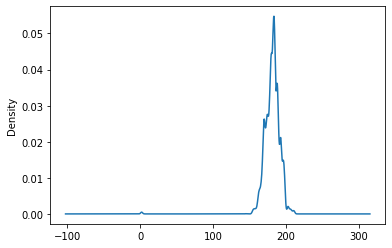

In [14]:
df_height_winner.plot.kde()
df_height_winner.mean()

In [15]:
fig = px.box(df_height_loser,y="loser_ht")
fig.show()

181.56308021278815

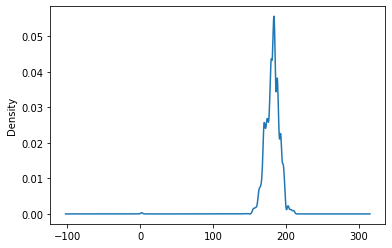

In [16]:
df_height_loser.plot.kde()
df_height_loser.mean()

### IOC

In [31]:
fig = px.histogram(df_matches['winner_ioc'])
fig.show()

In [32]:
fig = px.histogram(df_matches['loser_ioc'])
fig.show()

### Age

Outlier threshold for winner age: 40~42

In [125]:
df_winner_age = df_matches['winner_age']
fig = px.box(df_winner_age,y="winner_age")
fig.show()

<AxesSubplot:ylabel='Density'>

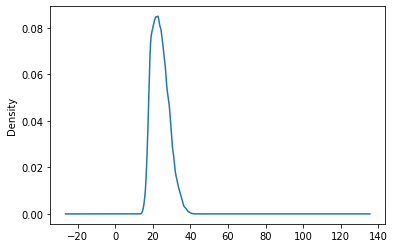

In [10]:
df_winner_age.plot.kde()

In [11]:
df_loser_age = df_matches['loser_age']
fig = px.box(df_loser_age ,y="loser_age")
fig.show()

Outlier threshold for loser age: 40~42

<AxesSubplot:ylabel='Density'>

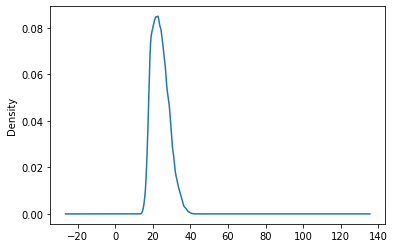

In [12]:
df_winner_age.plot.kde()

### Best_of

From the chart below we can notice that most of the games are best of 3. Therefore, we will substitute missing values with 3.

In [20]:
fig = px.histogram(df_matches['best_of'])
fig.show()

### Round

As expected:
- the finals (F) are closely half of the semifinals (SF)
- the semifinals (F) are closely half of the quarter finals (QF)
- and so on...

Moreover, we think that R64 or R128 matches are less than R32 because most of the tournaments start with a draw of 32 players

In [66]:
df_round= df_matches['round']
fig = px.histogram(df_round)
fig.show()

### Minutes

Threshold minutes: 1-300

In [17]:
df_minutes= df_matches['minutes']
#df = px.data.tips()
#fig = px.box(df, y="total_bill")
#fig.show()

fig = px.box(df_minutes,y="minutes")
fig.show()

97.6757531227039

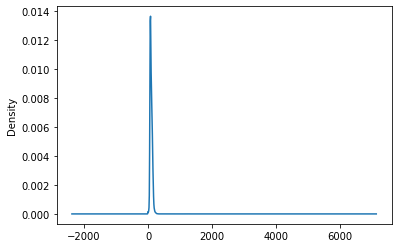

In [18]:
df_minutes.plot.kde()
df_minutes.mean()

### Ace

In [81]:
df_winner_ace = df_matches["w_ace"]

fig = px.histogram(df_winner_ace)
fig.show()


In [85]:
df_w_ace = df_matches['w_ace']

fig = px.box(df_w_ace, y="w_ace")
fig.show()

In [88]:
df_loser_ace = df_matches["l_ace"]

fig = px.histogram(df_loser_ace)
fig.show()

In [87]:
df_l_ace = df_matches['l_ace']

fig = px.box(df_l_ace, y="l_ace")
fig.show()

### Double Faul

In [89]:
df_winner_df = df_matches["w_df"]

fig = px.histogram(df_winner_df)
fig.show()

In [97]:
df_winner_df = df_matches["w_df"]
fig = px.box(df_winner_df, y="w_df")
fig.show()

In [90]:
df_loser_df = df_matches["l_df"]

fig = px.histogram(df_loser_df)
fig.show()

In [99]:
df_loser_df = df_matches["l_df"]
fig = px.box(df_loser_df, y="l_df")
fig.show()

### Serve points

In [119]:
df_w_svpt = df_matches["w_svpt"]

fig = px.histogram(df_w_svpt)
fig.show()

In [98]:
df_w_svpt = df_matches['w_svpt']

fig = px.box(df_w_svpt, y="w_svpt")
fig.show()

In [106]:
df_l_svpt = df_matches["l_svpt"]

fig = px.histogram(df_l_svpt)
fig.show()

In [108]:
df_l_svpt = df_matches['l_svpt']

fig = px.box(df_l_svpt, y="l_svpt")
fig.show()

### First served point

In [110]:
df_w_1stIn = df_matches['w_1stIn']
fig = px.histogram(df_w_1stIn)
fig.show()

In [105]:
fig = px.box(df_w_1stIn, y='w_1stIn')
fig.show()

In [117]:
df_l_1stIn = df_matches['l_1stIn']
fig = px.histogram(df_l_1stIn)
fig.show()

In [120]:
fig = px.box(df_l_1stIn, y='l_1stIn')
fig.show()

### 1st Won

In [122]:
df_w_1stwon = df_matches['w_1stWon']
fig = px.histogram(df_w_1stwon)
fig.show()

In [124]:
fig = px.box(df_w_1stwon, y='w_1stWon')
fig.show()

In [ ]:
df_l_1stwon = df_matches['l_1stWon']
fig = px.histogram(df_l_1stwon)
fig.show()

In [ ]:
fig = px.box(df_l_1stwon, y='l_1stWon')
fig.show()

### 2nd Won

In [123]:
df_w_2ndwon = df_matches['w_2ndWon']
fig = px.histogram(df_w_2ndwon)
fig.show()

In [ ]:
fig = px.box(df_w_2ndwon, y='w_2ndWon')
fig.show()

In [ ]:
df_l_2ndwon = df_matches['l_2ndWon']
fig = px.histogram(df_l_2ndwon)
fig.show()

In [ ]:
fig = px.box(df_l_2ndwon, y='l_2ndWon')
fig.show()

### SVGMS

In [126]:
df_w_svgms = df_matches['w_SvGms']
fig = px.histogram(df_w_svgms)
fig.show()

In [127]:
fig = px.box(df_w_svgms, y='w_SvGms')
fig.show()

In [ ]:
df_l_svgms = df_matches['l_SvGms']
fig = px.histogram(df_l_svgms)
fig.show()

In [ ]:
fig = px.box(df_l_svgms, y='l_SvGms')
fig.show()

### Bp Saved

In [ ]:
df_w_bpsaved = df_matches['w_bpSaved']
fig = px.histogram(df_w_bpsaved)
fig.show()

In [ ]:
fig = px.box(df_w_bpsaved, y='w_bpSaved')
fig.show()

In [ ]:
df_l_bpsaved = df_matches['l_bpSaved']
fig = px.histogram(df_l_bpsaved)
fig.show()

In [ ]:
fig = px.box(df_l_bpsaved, y='l_bpSaved')
fig.show()

### Bp Faced

In [ ]:
df_w_bpfaced = df_matches['w_bpFaced']
fig = px.histogram(df_w_bpfaced)
fig.show()

In [ ]:
fig = px.box(df_w_bpfaced, y='w_bpFaced')
fig.show()

In [ ]:
df_l_bpfaced = df_matches['l_bpFaced']
fig = px.histogram(df_l_bpfaced)
fig.show()

In [ ]:
fig = px.box(df_l_bpfaced, y='l_bpFaced')
fig.show()

### Winner Rank

To see the most significant tournaments, we compute the average of the winner ranks for each tourney:

In [63]:
df_rank_tourney = df_matches.groupby('tourney_name').agg({"winner_rank" : "mean"})
# call reset_index method
df_rank_tourney = df_rank_tourney.reset_index()
fig = px.histogram(x = df_rank_tourney['tourney_name'], y = df_rank_tourney['winner_rank'])
fig.show()

As expected, tourneis such as Davis Cup have lower average ranks than tourneis such as Prokuplije 10k

We study the distibution of the attribute with the usual box plot:

In [48]:
df_winner_rank = df_matches['winner_rank']
fig = px.box(df_winner_rank,y="winner_rank")
fig.show()

## Correlation among attributes


We create the correlation matrix between all the attributes of the dataset. We noticed that there is **high** correlation:

- Between **draw_size** and **tourney_spectators** with a correlation of ```0.93```, that makes sense because the higher is the number of partipants, the higher will be the number of match and therefore of spectators. 
- **Tourney_revenue** and **tourney_spectators** have a correlation of ```0.9```, which seems reasonable since the revenue is linked to the amount of spectators
- There happens to be also correlation between **draw_size** and **tourney_revenue**, the bigger is the draw_size of the tourney the bigger is its revenue
- For both winner and loser there's correlation between the number of breakpoints faced (**W_bdFaced**, **L_bpfaced**) and the number of breakpoints saved (**W_bdSaved**, **L_bdSaved**)
- There're other obvious correlations like the one between **w_SvGms** and **L_SvGms** indicating that the number of served games for both winner and loser are nearly the same, 

In [28]:
corrMatrix = df_matches.corr() 
fig = px.imshow(corrMatrix)
fig.show()

In [29]:
df_matches['w_df'].corr(df_matches['match_num'])

-0.020519012719820616

In [34]:
fig = px.scatter(x = df_matches['w_SvGms'], y = df_matches['l_SvGms'], trendline="ols")
fig.show()

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=de87b132-0371-4d99-94f9-c61923e2507d' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>